<h3><b>PART2 : EDA and Visualization </b> </h3>
<h4>The primary goal of performing EDA and visualization is to maximize the end-user's insight into a data set and into the underlying structure of a dataset </h4>

### Installing Required Libraries

In [3]:
!pip install wordcloud
!pip install geopandas
!pip install folium

## Import Required Libraries

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import plotly.graph_objs as go
import plotly.offline as py
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
from collections import Counter
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import geopandas as gpd

In [2]:
df= pd.read_csv("/Users/anushkasandesara/Desktop/Joined_accident_and_weather_data.csv")

/Users/anushkasandesara/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning:

Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.



## Which factors contributed in highest injuries/deaths?

In [3]:
sample_df= df
sample_df = sample_df.groupby(['Contributing_factor_1'])\
['Num_person_killed', 'Num_person_injured'].agg('sum').reset_index()
sample_df_killed = sample_df.sort_values('Num_person_killed', ascending = False).head(11)
sample_df_killed = sample_df_killed[1:11]
sample_df_injured = sample_df.sort_values('Num_person_injured', ascending = False).head(11)
sample_df_injured = sample_df_injured[1:11]

<ipython-input-3-742ee9bb5cee>:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



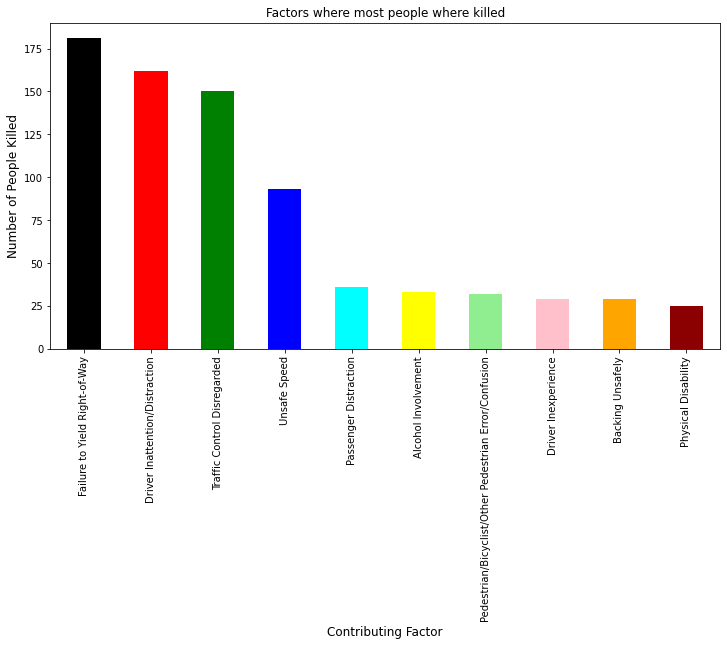

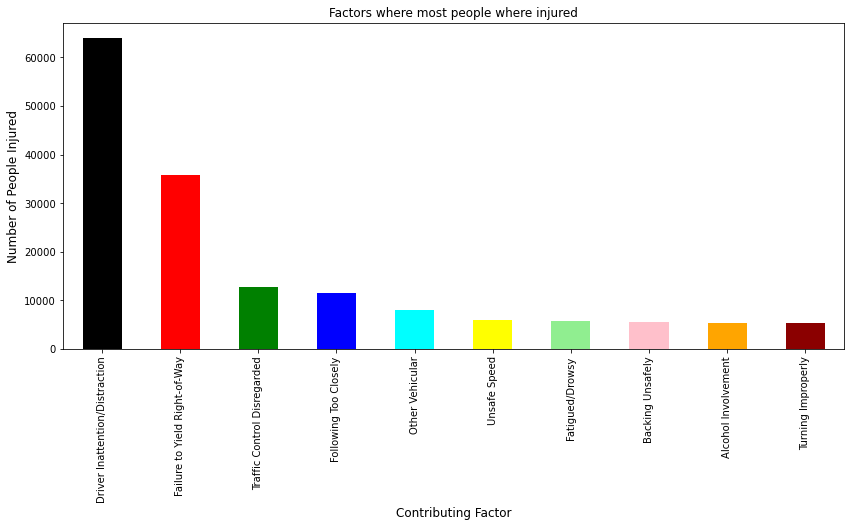

In [4]:
fig, ax = plt.subplots(1, figsize=(12, 6))
fig, ax1 = plt.subplots(1, figsize=(14, 6))



sample_df_killed.plot(x = 'Contributing_factor_1', 
                      y = 'Num_person_killed', kind = 'bar', 
                      stacked = True, ax = ax, color=['black', 'red', 'green', 'blue', 'cyan', 'yellow', 'lightgreen', 'pink', 'orange', 'darkred'])


ax.set_title('Factors where most people where killed', size = 12)
ax.set_xlabel('Contributing Factor', size = 12)
ax.set_ylabel('Number of People Killed', size = 12)
ax.get_legend().remove() #As we have used various colors here we removed the legend 


sample_df_injured.plot(x = 'Contributing_factor_1', 
                      y = 'Num_person_injured', kind = 'bar', color=['black', 'red', 'green', 'blue', 'cyan', 'yellow', 'lightgreen', 'pink', 'orange', 'darkred'],
                      stacked = True, ax = ax1)


ax1.set_title('Factors where most people where injured', size = 12)
ax1.set_xlabel('Contributing Factor', size = 12)
ax1.set_ylabel('Number of People Injured', size = 12)
ax1.get_legend().remove()

<h3> <b> Analysis </b> </h3>
The two plots depicts here that average of people who were injured in the collisions is approximately around 6500 while the deaths were around 175. The top 10 contributing factors are shown to understand what factors contribute the highest in collisions. Now we know that Driver Inattention, failure to Yield Righh-of-Way and Traffic Control Disregarded are factors where most people were injured and killed.

## What is the proportion of Contributing Factors in collisions happening?

Text(0.5, 0, 'Frequency')

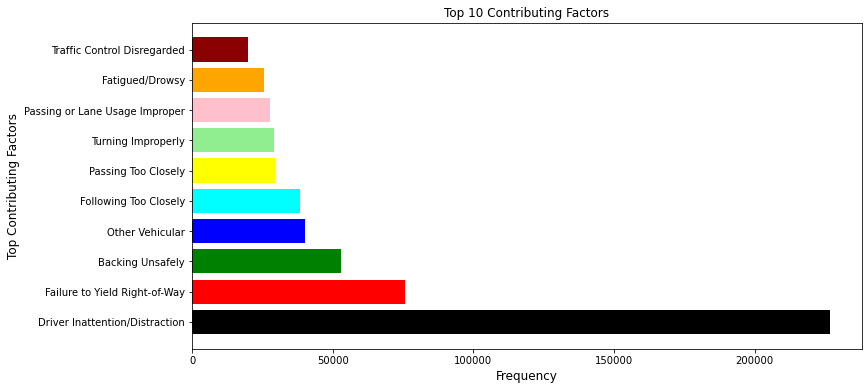

In [21]:
fig, ax = plt.subplots(1, figsize=(12, 6))
temp_dict=df['Contributing_factor_1'].value_counts().to_dict()
out = dict(list(temp_dict.items())[1: 11])
names = list(out.keys())
values = list(out.values())
plt.barh(range(len(out)), values, tick_label=names,color=['black', 'red', 'green', 'blue', 'cyan', 'yellow', 'lightgreen', 'pink', 'orange', 'darkred'] )

ax.set_title('Top 10 Contributing Factors', size = 12)
ax.set_ylabel('Top Contributing Factors', size = 12)
ax.set_xlabel('Frequency', size = 12)


## Which Borough has maximum collisions happening and how many people were injured and killed?

In [5]:
borough_wise = df.groupby(['Borough'])\
['Num_person_injured', 'Num_person_killed'].agg('sum').reset_index()
borough_wise['Total Accidents'] = df.groupby(['Borough']).size().reset_index(name='NoOfAccidents').NoOfAccidents
borough_wise

<ipython-input-5-4cd022e91840>:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Borough,Num_person_injured,Num_person_killed,Total Accidents
0,BRONX,52366.0,189.0,176624
1,BROOKLYN,117346.0,474.0,387635
2,MANHATTAN,52210.0,252.0,280544
3,QUEENS,90333.0,422.0,330186
4,STATEN ISLAND,13578.0,77.0,51709


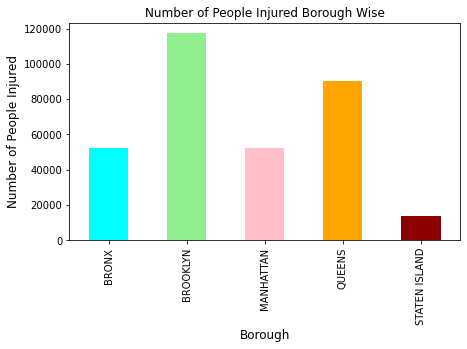

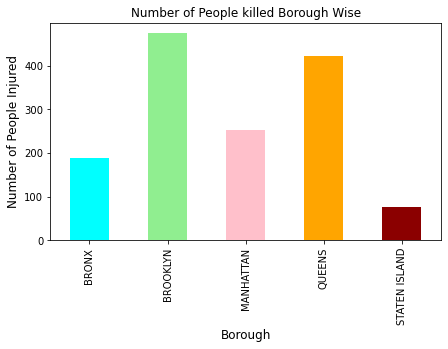

In [18]:

fig, ax = plt.subplots(1, figsize=(7, 4))
fig, ax1 = plt.subplots(1, figsize=(7, 4))

borough_wise.plot(x = 'Borough', 
                      y = 'Num_person_injured', kind = 'bar', color=[ 'cyan', 'lightgreen', 'pink', 'orange', 'darkred'],ax = ax ,  stacked = True)

ax.set_title('Number of People Injured Borough Wise', size = 12)
ax.set_xlabel('Borough', size = 12)
ax.set_ylabel('Number of People Injured', size = 12)
ax.get_legend().remove()



borough_wise.plot(x = 'Borough', 
                      y = 'Num_person_killed', kind = 'bar', color=[ 'cyan', 'lightgreen', 'pink', 'orange', 'darkred'],
                      stacked = True, ax = ax1)

ax1.set_title('Number of People killed Borough Wise', size = 12)
ax1.set_xlabel('Borough', size = 12)
ax1.set_ylabel('Number of People Injured', size = 12)
ax1.get_legend().remove()

<h3> <b> Analysis </b> </h3>
The two bar plots shows that maximum people were killed/injured in Brooklyn followed by Queens. We further read across various [articles](https://jknylaw.com/new-york-car-accident-lawyer/statistics/) published and understood that Brooklyn has the most deadly intersections and major collisions happen in Brooklyn due to Driver Inattention. We also observed that Staten Island has the least number of collisions as it has 1/5th population density in comparison to Brooklyn.


## Dangerous Streets where highest people were injured

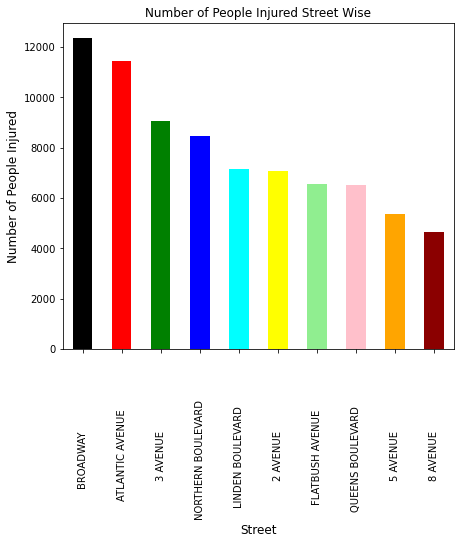

In [16]:
street_count = df.groupby(['On_street_name'])['On_street_name'].count().reset_index(name='Collisions')
street_count = street_count.sort_values('Collisions', ascending = False).head(10)
fig, ax = plt.subplots(1, figsize=(7, 6))
street_count.plot(x = 'On_street_name', 
                      y = 'Collisions', kind = 'bar', color=['black', 'red', 'green', 'blue', 'cyan', 'yellow', 'lightgreen', 'pink', 'orange', 'darkred'],ax = ax ,  stacked = True)

ax.set_title('Number of People Injured Street Wise', size = 12)
ax.set_xlabel('Street', size = 12)
ax.set_ylabel('Number of People Injured', size = 12)
ax.get_legend().remove()
plt.show()

<h3> <b> Analysis </b> </h3> 
From the streets we looked up the boroughs manually and came to conclusion that the streets where most collisions and injuries happened is Brooklyn. There are variety of reasons behind this like Driver Inattention, Following Too closely , deadly intersection and many others.

## What is Distribution of People Killed/Injured in Collisions?

/Users/anushkasandesara/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/Users/anushkasandesara/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:title={'center':'Killed Frequency'}>

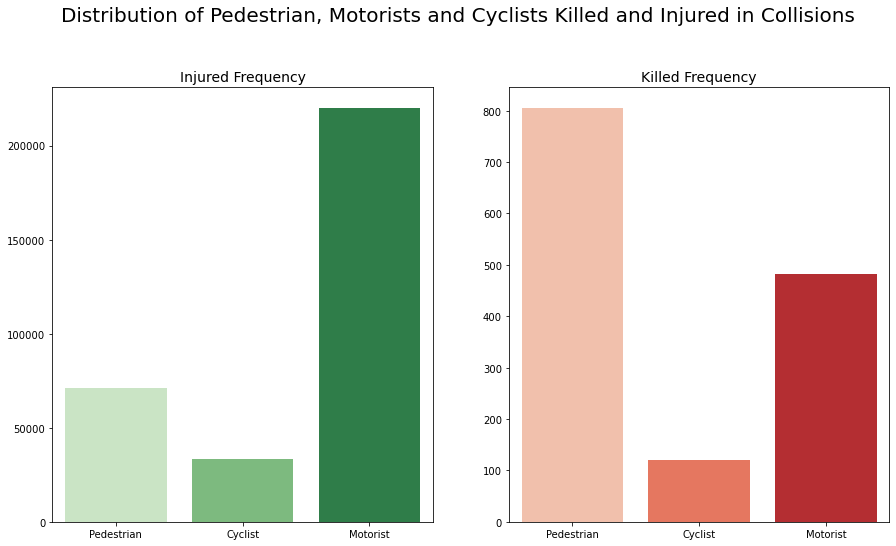

In [8]:
df_injured = df[[i for i in df.columns for c in ['Num_pedestrians_injured', 'Num_cyclist_injured', 'Number_motorist_injured'] if c in i]].sum()
df_killed = df[[i for i in df.columns for c in ['Num_pedestrians_killed', 'Num_cyclist_killed', 'Number_motorist_killed'] if c in i]].sum()
df_injured.index = ['Pedestrian', 'Cyclist', 'Motorist']
df_killed.index = ['Pedestrian', 'Cyclist', 'Motorist']


fig, ax = plt.subplots(1,2,figsize=(15,8))
plt.suptitle('Distribution of Pedestrian, Motorists and Cyclists Killed and Injured in Collisions', fontsize=20, x=0.5,y=1.02)
ax[0].set_title('Injured Frequency', fontsize=14)
ax[1].set_title('Killed Frequency', fontsize=14)

sns.barplot(df_injured.index, df_injured.values, ax=ax[0], palette='Greens')
sns.barplot(df_killed.index, df_killed.values, ax=ax[1], palette='Reds')

<h3> <b> Analysis </b> </h3>
From the 2 bar plots we observed here that while considering frequency of injured people most of them were motorists but if freuency of people getting killed is considered then most of them were pedestrians. Further we noted that the cyclists were least injured/killed in comparison to Motorists and Pedestrians while collisions happened.

## What is the distribution of Collisions by Part of Day?

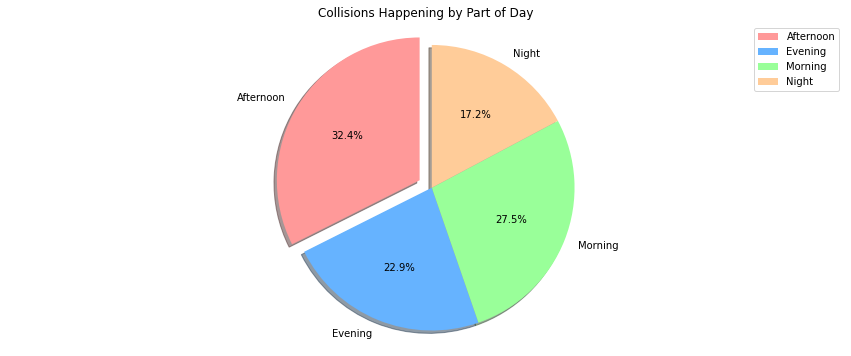

In [9]:
part_day_df = df.groupby(['Part_of_day'])['Part_of_day'].count().reset_index(name='Collisions')
fig, ax = plt.subplots(figsize=(15,6))
explode = (0.1, 0, 0, 0)  
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99']

ax.pie(part_day_df.Collisions,
       labels=part_day_df.Part_of_day,
       autopct='%1.1f%%',
       explode = explode,
       colors = colors, 
       shadow=True,
       startangle=90)
ax.axis('equal')  
ax.legend(part_day_df.Part_of_day)
ax.set_title('Collisions Happening by Part of Day')


plt.show()

<h3> <b> Analysis </b> </h3>
From the timestamp we derived hour and then divided the whole data into 4 parts- Morning, Afternoon, Evening and Night to exactly visualize which part of the day has maximum collisions. From the pie chart we deduced that maximum collisions happened in afternoon followed by morning. We tried to dig deep by going through existing studies and found that highest collisions happen during rush hour that is were most people are leaving for officework.

In [11]:
borough_part_day_df = df.groupby(['Part_of_day', 'Borough'])['Borough'].count().reset_index(name='Collisions')
brooklyn_df = borough_part_day_df[borough_part_day_df['Borough'] == 'BROOKLYN'] 
manhattan_df = borough_part_day_df[borough_part_day_df['Borough'] == 'MANHATTAN'] 
queens_df =  borough_part_day_df[borough_part_day_df['Borough'] == 'QUEENS'] 
bronx_df =  borough_part_day_df[borough_part_day_df['Borough'] == 'BRONX'] 
staten_island_df =  borough_part_day_df[borough_part_day_df['Borough'] == 'STATEN ISLAND']

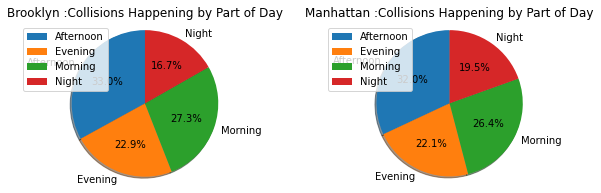

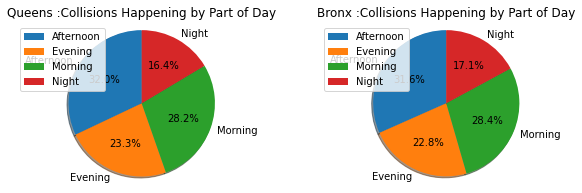

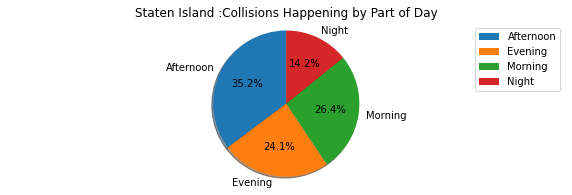

In [14]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(10,3)) #ax1,ax2 refer to your two pies
fig, (ax3,ax4) = plt.subplots(1,2, figsize=(10,3)) #ax1,ax2 refer to your two pies
fig, ax5 = plt.subplots(1, figsize=(10,3)) 

# 1,2 denotes 1 row, 2 columns - if you want to stack vertically, it would be 2,1
ax1.pie(brooklyn_df.Collisions,
       labels=brooklyn_df.Part_of_day,
       autopct='%1.1f%%',
       shadow=True,
       startangle=90)
ax1.axis('equal')  
ax1.set_title('Brooklyn :Collisions Happening by Part of Day')
ax1.legend(part_day_df.Part_of_day)



ax2.pie(manhattan_df.Collisions,
       labels=manhattan_df.Part_of_day,
       autopct='%1.1f%%',
       shadow=True,
       startangle=90)
ax2.axis('equal')  
ax2.set_title('Manhattan :Collisions Happening by Part of Day')
ax2.legend(part_day_df.Part_of_day)



ax3.pie(queens_df.Collisions,
       labels=queens_df.Part_of_day,
       autopct='%1.1f%%',
       shadow=True,
       startangle=90)
ax3.axis('equal')  
ax3.set_title('Queens :Collisions Happening by Part of Day')
ax3.legend(part_day_df.Part_of_day)




ax4.pie(bronx_df.Collisions,
       labels=bronx_df.Part_of_day,
       autopct='%1.1f%%',
       shadow=True,
       startangle=90)
ax4.axis('equal')  
ax4.set_title('Bronx :Collisions Happening by Part of Day')
ax4.legend(part_day_df.Part_of_day)



ax5.pie(staten_island_df.Collisions,
       labels=staten_island_df.Part_of_day,
       autopct='%1.1f%%',
       shadow=True,
       startangle=90)
ax5.axis('equal')  
ax5.set_title('Staten Island :Collisions Happening by Part of Day')
ax5.legend(part_day_df.Part_of_day)




<h3> <b> Analysis </b> </h3>
We tried checking for collisions by part of day for each borough but there was no specific trend observed. For all the boroughs the maximum collisions happened in afternoon followed by Morning which is when most people start going to their offices and there is heavy traffic.


### What is Impact of Weather on Collisions?

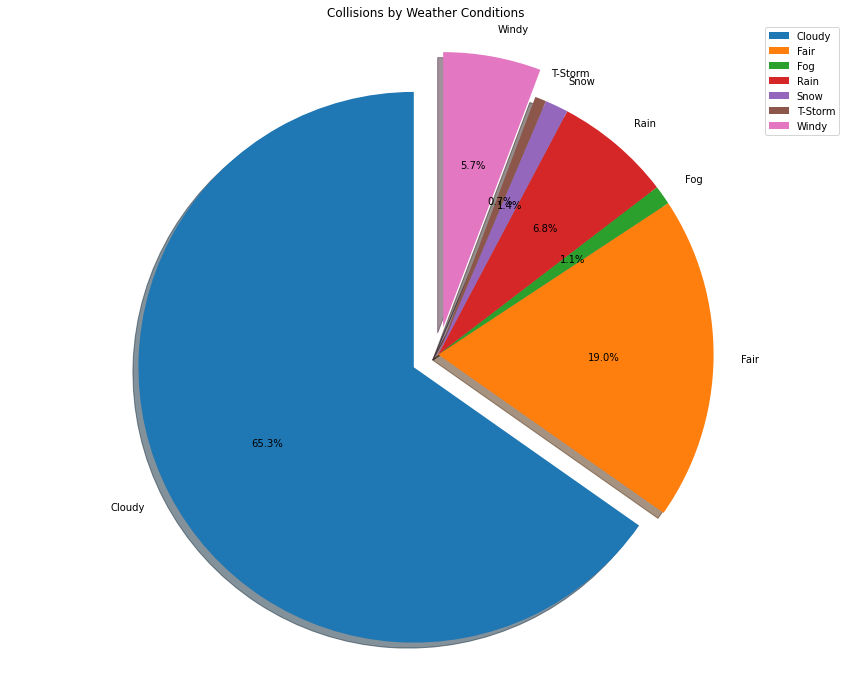

In [29]:
pie_df = df.groupby(['Broader_weather_condition'])['Broader_weather_condition'].count().reset_index(name='Collisions')
fig, ax = plt.subplots(figsize=(15,12))
explode = (0.1, 0, 0, 0,0,0,0.1)  
ax.pie(pie_df.Collisions,
       labels=pie_df.Broader_weather_condition,
       explode = explode, 
       autopct='%1.1f%%',
       shadow=True,
       startangle=90)
ax.axis('equal')  
ax.set_title('Collisions by Weather Conditions')
ax.legend(pie_df.Broader_weather_condition)




plt.show()

<h3> <b> Analysis </b> </h3>
We joined the data initially with the scraped weather data to check what weather conditions affect the collisions taking place. From the pie chart we observed that most of the collisions happen on a cloudy day followed by a Fair weather condition. We wanted to understand the reason behind this so we read across various blogs and [articles](https://www.1800lawguys.com/blog/cloudy-weather-linked-to-5000-fatal-car-accidents-a-year/) published on this and came to know that Cloudy conditions are the No. 1 cause of fatal collisions, according to data from the National Highway Traffic Safety Administration (NHTSA). Some Reasons behind this are- Cloudy skies can make driving more dangerous because it decreases visibility, make it harder to see potholes, black ice, and unplowed roads



## Wordcloud- To analyze which streets are frequently facing collisions?

In [32]:
c1= Counter(on_street_name)
c1.most_common()

[('BROADWAY                        ', 12341),
 ('ATLANTIC AVENUE                 ', 11436),
 ('3 AVENUE                        ', 9065),
 ('NORTHERN BOULEVARD              ', 8450),
 ('LINDEN BOULEVARD                ', 7139),
 ('2 AVENUE                        ', 7056),
 ('FLATBUSH AVENUE                 ', 6541),
 ('QUEENS BOULEVARD                ', 6532),
 ('5 AVENUE                        ', 5377),
 ('8 AVENUE                        ', 4636),
 ('HYLAN BOULEVARD                 ', 4501),
 ('10 AVENUE                       ', 4486),
 ('7 AVENUE                        ', 4426),
 ('1 AVENUE                        ', 4420),
 ('JAMAICA AVENUE                  ', 4373),
 ('WOODHAVEN BOULEVARD             ', 4284),
 ('NOSTRAND AVENUE                 ', 4142),
 ('BRUCKNER BOULEVARD              ', 4134),
 ('HILLSIDE AVENUE                 ', 4042),
 ('BEDFORD AVENUE                  ', 4040),
 ('EASTERN PARKWAY                 ', 4024),
 ('NORTH CONDUIT AVENUE            ', 3827),
 ('UTICA

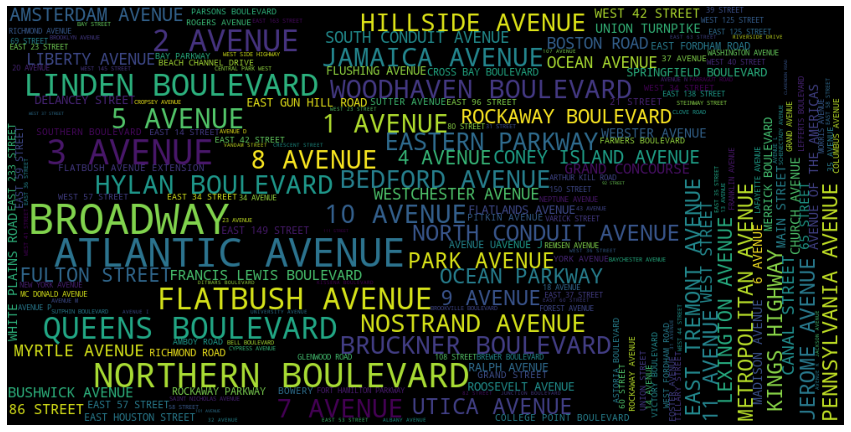

In [33]:
on_street_name= df['On_street_name'].dropna()
c1= Counter(on_street_name)
wordcloud = WordCloud(background_color= 'BLACK', width = 1000, height = 500).generate_from_frequencies(c1)
plt.figure(figsize=(15,10))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()
plt.close()

<h3> <b> Analysis </b> </h3>
We wanted to analyze the dangerous streets in NYC and we used Counter to create a dictionary of key:value pairs of street and the counts. We sorted it in descending order to just see the dangerous streets and then we plotted the Wordcloud using the result of Counter.The main benefit from this visual is the more bigger the word appears in the wordcloud the more often collisions happen there. 

## Time Series Analysis using Plotly

In [35]:
import calendar
date_time_df= df
#Extract DateTime features
date_time_df['collisions_datetime'] = pd.to_datetime(df['Crash_date'], infer_datetime_format = True)   #infer_datetime_format=True) 
date_time_df['collisions_time'] = pd.to_datetime(df['Crash_time'], infer_datetime_format = True) 


date_time_df.loc[:, 'collisions_weekday'] = date_time_df['collisions_datetime'].dt.weekday
date_time_df.loc[:, 'collisions_weekofyear'] = date_time_df['collisions_datetime'].dt.weekofyear
date_time_df.loc[:, 'collisions_hour'] = date_time_df['collisions_time'].dt.hour
date_time_df.loc[:, 'collisions_minute'] = date_time_df['collisions_time'].dt.minute
#date_time_df.head()

date_time_df['weekday_name']=date_time_df['collisions_weekday'].apply(lambda x: calendar.day_name[x])

<ipython-input-35-99674d051878>:9: FutureWarning:

Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.



In [36]:

days_list=list()
total_collisions=0
day_dict={0:"Monday",1:"Tuesday",2:"Wednesday",3:"Thursday",4:"Friday",5:"Saturday",6:"Sunday"}
for i in range(0,7):
    day_filt = date_time_df[date_time_df['collisions_weekday'] == i]
    df_day_hour_groupby = day_filt.groupby('collisions_hour').count()
    day_crash_time = list(df_day_hour_groupby['Crash_time'])
    total_collisions+=sum(day_crash_time)
    collisions_hour_wise = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]
    each_day = go.Scatter(x = collisions_hour_wise, y = day_crash_time,  mode = "lines+markers", name = day_dict[i])
    days_list.append(each_day)

layout = dict(title = 'Weekly Analysis of Collisions per Hour', 
              xaxis= dict(title= 'Hour',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'Number of Collisions Happening',ticklen= 5,zeroline= False)
             )
fig = dict(data=days_list, layout=layout)
py.iplot(fig, filename='timeline-lineplot')


<h3> <b> Analysis </b> </h3>
For in-depth analysis from Monday to Sunday for various hours we created a Plotly Time Series Plot. From the plot we understood that:-

1. Maximum collisions happened on weekdays( Monday- Friday) compared to weekends (Saturday and Sunday). We deduced that people will have busy schedules on weekdays as they would be occupied with businesswork and other mundane activities which would lead to heavy traffic and more collisions.

2. The number of collisions happening increased a lot during 9-11 AM because the time duration is considered to be rush hour and then the collisions dropped comparitively.

3. The number of collisions happening increased a lot again during evening and the reason we deduced from this is people might be returning back from their business and heading home so there might be heavy traffic and then it dropped again.

## Borough Wise Time Series Analysis- Plotly

In [37]:
total_collisions=0
boroughs=list(date_time_df['Borough'].dropna().unique())

day_dict={0:"Monday",1:"Tuesday",2:"Wednesday",3:"Thursday",4:"Friday",5:"Saturday",6:"Sunday"}

for borough in boroughs:

    days_list=list()
    print(borough)
    days_list=list()
    df_borough_filtered=date_time_df[date_time_df['Borough'] == borough]
    for i in range(0,7):
        day_filt=df_borough_filtered[df_borough_filtered['weekday_name'] == day_dict[i]  ]


        df_day_hour_groupby = day_filt.groupby('collisions_hour').count()
        day_crash_time = list(df_day_hour_groupby['Crash_time'])
        total_collisions+=sum(day_crash_time)
        collisions_hour_wise = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]
        each_day = go.Scatter(x = collisions_hour_wise, y = day_crash_time,  mode = "lines+markers", name = day_dict[i])
        days_list.append(each_day)

    layout = dict(title = 'Borough Wise Analysis of Collisions per Hour', 
                xaxis= dict(title= 'Hour',ticklen= 5,zeroline= False),
                yaxis= dict(title= 'Number of Collisions Happening',ticklen= 5,zeroline= False)
              )
    fig = dict(data=days_list, layout=layout)
    py.iplot(fig, filename='timeline-lineplot')


BROOKLYN


BRONX


STATEN ISLAND


QUEENS


MANHATTAN


<h3> <b> Analysis </b> </h3>

We created Borough Wise Plotly Time Series Plots to analyze the collisions happening per hour in each Borough. 
1. For all Boroughs a general trend was observed that on weekends there were lesser collisions taking place compared to weekdays.
2. Brooklyn and Queens Borough experienced more collisions approximately around 4k compared to other Boroughs.
3. Higher number of collisions were observed in all Boroughs during rush hour (8-11AM) and evening time when people return from their offices.

## Number of Collisions by Borough-Geopandas Map Plots 

In [38]:
map= gpd.read_file("/Users/anushkasandesara/Desktop/Borough Boundaries")
borough_count = date_time_df.groupby(['Borough'])['Borough'].count().reset_index(name='Collisions')
map['boro_name'] = map['boro_name'].str.upper()
map.rename(columns={'boro_name':'Borough'}, inplace=True)
geo_map = map.merge(borough_count, on='Borough')

In [39]:
geo_map

,boro_code,Borough,shape_area,shape_leng,geometry,Collisions
0,2.0,BRONX,1.187194e+09,463868.937681,"MULTIPOLYGON (((-73.89681 40.79581, -73.89694 ...",176624
1,1.0,MANHATTAN,6.365759e+08,359804.890798,"MULTIPOLYGON (((-74.01093 40.68449, -74.01193 ...",280544
2,5.0,STATEN ISLAND,1.623636e+09,325929.794027,"MULTIPOLYGON (((-74.05051 40.56642, -74.05047 ...",51709
3,3.0,BROOKLYN,1.934174e+09,728195.197649,"MULTIPOLYGON (((-73.86327 40.58388, -73.86381 ...",387635
4,4.0,QUEENS,3.040205e+09,900270.512975,"MULTIPOLYGON (((-73.82645 40.59053, -73.82642 ...",330186


<ipython-input-41-7f407962fd7f>:4: MatplotlibDeprecationWarning:

The 's' parameter of annotate() has been renamed 'text' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.



(-74.28337047811607, -73.67222994890952, 40.47514452614866, 40.936503645040624)

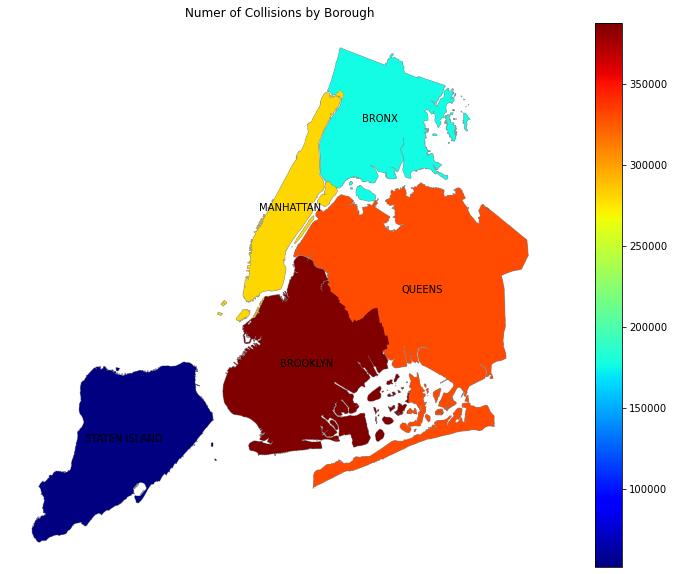

In [41]:
fig,ax = plt.subplots(figsize=(15,10))
geo_map.plot(ax=ax,alpha=0.4,edgecolor='black')
geo_map.plot(column='Collisions',ax=ax,legend=True,cmap='jet',markersize=4)
geo_map.apply(lambda x: ax.annotate(s=x.Borough, color='black', xy=x.geometry.centroid.coords[0],ha='center'), axis=1)

plt.title("Numer of Collisions by Borough")
plt.axis('off')

<h3> <b> Analysis </b> </h3>
We wanted to experiment with different Python libraries for this project so after Plotly we explored Geopandas library which is said to be very useful for geospatial analysis and create static and interactive python plots that are visually appealing. For this analysis we used shape files and necessary geoJSON files which we downloaded from the [website](https://opendata.cityofnewyork.us/projects/boundaries-map/).

We created geopandas dataframe using this data and then created a plot after grouping and finding collisions borough wise. For plot we experimented with various colormaps like viridis, jet, inferno, Purples, YlGnBu and various others. For jet colormap we were able to see the dark red highlighted portions in Brooklyn and Queens Borough were maximum collisions happened.

## Interactive Folium plots 

In [19]:
#Distribution of accidents in Brooklyn
#Distribution of accidents 
data = df.dropna(subset=['Latitude', 'Longitude'])
borough_dict={}
marker_cluster_dict={}
for borough in data['Borough'].dropna().unique():
    df1=data.loc[data['Borough'] == borough]
    df1= df1.head(10000)
    borough_dict[borough]=folium.Map(location=[40.638177,-73.964160],tiles="stamenterrain",zoom_start=11)
    marker_cluster_dict[borough] = MarkerCluster().add_to(borough_dict[borough])

    locations = df1[['Latitude', 'Longitude']]
    locationlist = locations.values.tolist()

    for point in range(0, len(locationlist)):
        folium.Marker(locationlist[point]).add_to(marker_cluster_dict[borough])
    

In [20]:
print("Analysis of Collisions in Brooklyn Borough")
borough_dict['BROOKLYN']

Analysis of Collisions in Brooklyn Borough


In [49]:
print("Analysis of Collisions in Bronx Borough")
borough_dict['BRONX']

Analysis of Collisions in Bronx Borough


In [50]:
print("Analysis of Collisions in Staten Island Borough")
borough_dict['STATEN ISLAND']

Analysis of Collisions in Staten Island Borough


In [51]:
print("Analysis of Collisions in Queens Borough")
borough_dict['QUEENS']

Analysis of Collisions in Queens Borough


In [52]:
print("Analysis of Collisions in Manhattan Borough")
borough_dict['MANHATTAN']

Analysis of Collisions in Manhattan Borough


<h3> <b> Analysis </b> </h3>
After geopandas library we explored Folium library to create interactive python visuals that can be used for analysis. Folium makes it easy to visualize data that’s been manipulated in Python, on an interactive Leaflet map.

1. We created Folium plots for each Borough for the initial 10,000 rows in the dataframe.
2. The markers in the plots are interactive and on clicking them exact locations and streets can be visualized where collision happened.
3. This is very effective as to reduce the collisions taking place the police department can easily access the high alert streets and the exact location on the folium plot where the accidents happened. Moreover, precaution and extra safety can be managed in the specific areas where needed.

## Detailed Analysis of High Collision Spots along with necessary information where collision happened

In [21]:
location = df['Location'].value_counts()
location_counts = pd.DataFrame({"Location" : location.index, "Count":location})
location_counts.index = range(len(location))

In [22]:
location = df.groupby('Location').first()
new_df_location = location.loc[:, ['Latitude', 'Longitude', 'Zip_code', 'On_street_name', 'Borough']]
loc_groupby = pd.merge(location_counts,new_df_location,on='Location')
loc_groupby.drop(loc_groupby.index[0], inplace=True)

In [23]:
map = folium.Map(location=[40.721757, -73.930529],
                        zoom_start=13)

for i in range(500):
    lat = loc_groupby.iloc[i][2]
    long = loc_groupby.iloc[i][3]
    radius = loc_groupby['Count'].iloc[i] / 30
    
    if loc_groupby['Count'].iloc[i] > 300:
        color = "#8B0000"
    else:
        color = "#4169E1"
    
    popup_text = """Latitude : {}
                Longitude : {}
                Zip Code : {}
                Street : {}
                Borough : {}
                Collisions :{} """
    popup_text = popup_text.format(loc_groupby['Latitude'].iloc[i],
                               loc_groupby['Longitude'].iloc[i],
                               loc_groupby['Zip_code'].iloc[i],
                               loc_groupby['On_street_name'].iloc[i],
                               loc_groupby['Borough'].iloc[i],
                               loc_groupby['Count'].iloc[i]
                               )
    folium.CircleMarker(location = [lat, long], popup= popup_text,radius = radius, color = color, fill = True).add_to(map)
print("Detailed Analysis and Comparison of High and Low Collision Spots with Necessary Information")
map


Detailed Analysis and Comparison of High and Low Collision Spots with Necessary Information


<h3> <b> Analysis </b> </h3>
We further wanted to create something like Google Maps using Folium which can give the exact information of the collision spot along with important information like- Latitude, Longitude, Zip Code, Street, Borough and number of collisions.

Here in this visualization if user hovers on the **Blue** markers(less collisions than Red spots) then the required information regarding collision can be obtained easily and if user hovers on the **Red** markers which are specifically the high-alert spots as higher number of collisions happened there compared to Blue marker points

The interactive plots will be beneficial in real-time as even **just taking a look at the visual many things can be interpreted easily 👀**

<h3><b>For Next Part of the Project (Model Building- Supervised and Unsupervised ) please refer - Modeling.ipynb</b></h3>